In [25]:
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [26]:
#--------------------------------#
# Model PDE-1 (Linear advection) #
#--------------------------------#

# Initial condition: Gaussian pulse (Option-1)
def initial_conditions_gaussian(x):
    u0 = np.exp(-((x - 0.3) ** 2) / 0.01)
    return(u0)

# Initial condition: Step profile (Option-2)
def initial_conditions_step(x, nx):
    step_mask = np.where(abs(x-0.2)<0.1)
    u0 = np.zeros(nx)
    u0[step_mask] = 1.0
    return(u0)

# Initial condition: Sine profile (Option-3)
def initial_conditions_sine(x, L):
    u0 = np.sin(2*np.pi*x/L)
    return(u0)

# options for finite differencing
def ftbs(ui, uip1, uim1, uim2, dx, dt, c):
    return ui - c*dt/dx*(ui - uim1)
def ftcs(ui, uip1, uim1, uim2, dx, dt, c):
    return ui - c*dt/(2*dx)*(uip1 - uim1)
def ftfs(ui, uip1, uim1, uim2, dx, dt, c):
    return ui - c*dt/dx*(uip1 - ui)

# going to convert all of this to a function for convenience
def pde1(c, nx, L, dt, nt, ics, fd, fdstr):
    # Setup the grid
    x = np.linspace(0, L, nx)
    dx = L / nx

    # Point to the initial condition you want to use
    initial_conditions = ics

    # Set initial conditions
    u0 = initial_conditions(x, nx)

    # Set up the solution array u
    u = u0.copy()

    # Set up the exact solution for reference
    u_exact = u0.copy()

    # Store solution at each time step
    us = [u.copy()]

    # Store exact solution at each time step
    u_exacts = [u_exact.copy()]

    # Save L2 norm errors in an array
    errors = []

    time = 0.0
    for n in range(nt):
        time = time + dt
        # Numerical solution update
        u_new = u.copy()  
        for i in range(1, nx-1):
            # update with fd model
            u_new[i] = fd(u[i], u[i+1], u[i-1], u[i-2], dx, dt, c)
        u = u_new.copy()
        us.append(u.copy())
        
        # Exact solution update
        u_exact = initial_conditions(x-c*time, nx)
        u_exacts.append(u_exact.copy())
        
        # Calculate L2 norm error between numerical and exact solution
        error = 0.0
        for i in range(1,nx-1):
            error = error + (u_exact[i]-u[i])**2
        error = np.sqrt(error/(nx-2))
        errors.append(error)

    # Save the final result in a file for comparison at a later stage
    np.save(f'Solution-ModelPDE1-{fdstr}_Nx{nx:.0f}.npy', np.array([x,us[-1]]))
    
    return x, us, u_exacts, errors

# # Plot the errors with time 
# # Note you will only analyze the end-time error for this assignment
# plt.figure(2)
# plt.plot(errors)
# plt.xlabel('Iterations')
# plt.ylabel('L2 norm error')

plt.show()

# Part 1a

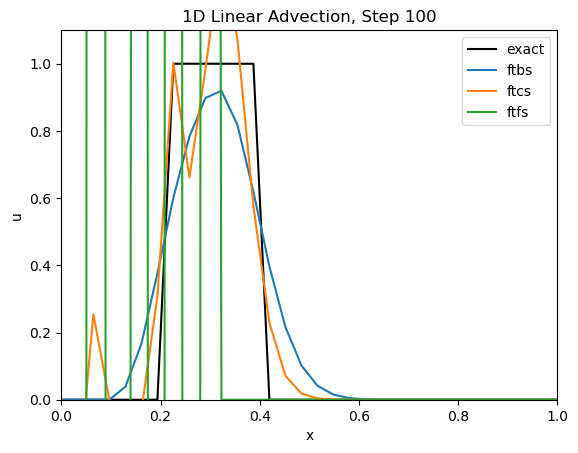

In [27]:
# Parameters
c = 1.0          # Advection speed
nx = 32          # Number of spatial points
L = 1.0          # Length of domain
dt = 0.001       # Time step
nt = 100         # Number of time steps

# run for each differencing option
x, usftbs, uexacts, errorsftbs = pde1(c, nx, L, dt, nt, initial_conditions_step, ftbs, "ftbs")
x, usftcs, _, errorsftcs = pde1(c, nx, L, dt, nt, initial_conditions_step, ftcs, "ftcs")
x, usftfs, _, errorsftfs = pde1(c, nx, L, dt, nt, initial_conditions_step, ftfs, "ftfs")

# Animation setup
fig, ax = plt.subplots()
line_exact, = ax.plot(x, uexacts[0], color='k', label='exact')
line_solutionftbs, = ax.plot(x, usftbs[0], label='ftbs')
line_solutionftcs, = ax.plot(x, usftcs[0], label='ftcs')
line_solutionftfs, = ax.plot(x, usftfs[0], label='ftfs')
ax.set_xlim(0, L)
ax.set_ylim(0, 1.1)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.legend()
ax.set_title(f'1D Linear Advection')

def update(frame):
    line_solutionftbs.set_ydata(usftbs[frame])
    line_solutionftcs.set_ydata(usftcs[frame])
    line_solutionftfs.set_ydata(usftfs[frame])
    line_exact.set_ydata(uexacts[frame])
    ax.set_title(f'1D Linear Advection, Step {frame}')
    return line_solutionftbs, line_solutionftcs, line_solutionftfs, line_exact

anim = FuncAnimation(fig, update, frames=len(uexacts), blit=True, interval=50)
HTML(anim.to_jshtml())

It is clear from the final time step that the forward time, backwards space method is most accurate. Since 1D linear
advection is an initial value problem, any spatial methods that use information from forward in time will be unstable
since they do not follow the physics of the problem correctly. Both central in space and forwards in space contain
information from in front of the wave, so they are unstable. This is visible in the final time step solution where both
forwards space and central space have blown up, but the backwards in space is still somewhat valid. It does show
significant diffusion and is not particularly accurate, but does represent a stable solution.

# Part 1b

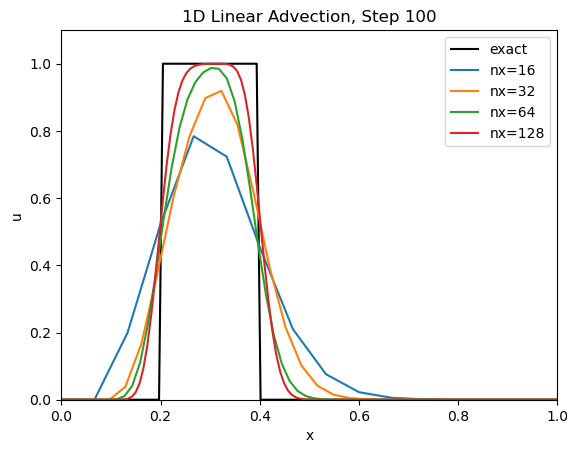

In [28]:
# Parameters
c = 1.0          # Advection speed
L = 1.0          # Length of domain
dt = 0.001       # Time step
nt = 100         # Number of time steps

# list of nxs to use
nxs = np.array([16, 32, 64, 128])

# run for each differencing option
us = {}
xs = {}
errs = np.empty(4); i=0
for nx in nxs:
    # run ft-bs
    x, usftbs, uexacts, errorsftbs = pde1(c, nx, L, dt, nt, initial_conditions_step, ftbs, "ftbs")
    
    # store soltn in dict
    us[nx] = usftbs
    xs[nx] = x
    errs[i] = errorsftbs[-1]; i+=1

# Animation setup
fig, ax = plt.subplots()
line_exact, = ax.plot(x, uexacts[0], color='k', label='exact')
line_solution16, = ax.plot(xs[16], us[16][0], label='nx=16')
line_solution32, = ax.plot(xs[32], us[32][0], label='nx=32')
line_solution64, = ax.plot(xs[64], us[64][0], label='nx=64')
line_solution128, = ax.plot(xs[128], us[128][0], label='nx=128')
ax.set_xlim(0, L)
ax.set_ylim(0, 1.1)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.legend()
ax.set_title(f'1D Linear Advection')

def update(frame):
    line_solution16.set_ydata(us[16][frame])
    line_solution32.set_ydata(us[32][frame])
    line_solution64.set_ydata(us[64][frame])
    line_solution128.set_ydata(us[128][frame])
    line_exact.set_ydata(uexacts[frame])
    ax.set_title(f'1D Linear Advection, Step {frame}')
    return line_solution16, line_solution32, line_solution64, line_solution128, line_exact

anim = FuncAnimation(fig, update, frames=len(uexacts), blit=True, interval=50)
HTML(anim.to_jshtml())

# # plot errors
# plt.figure()
# plt.loglog(nxs, errs)
# plt.loglog(nxs, errs[0]*(nxs/nxs[0])**(-0.5))
# plt.tight_layout()
# plt.show()

We can see at the final time step that the higher grid resolution is a more accurate solution. The lowest resolution, 16
points, has diffused to almost bellow 80\% of the expected value at the final time step. The highest resolution, 128 points, is
still at the peak of 1, although it has clearly started to diffuse. The slope of the sides is also much steeper, so
it is much closer to a step function, whereas the lowest resolution has spread out a lot and no longer shows something
resembling a step.

talk about error here

# Part 1c

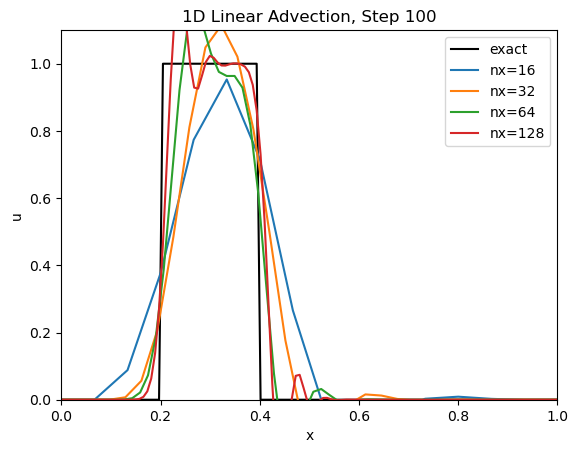

In [29]:
# make 2nd order ftbs
def ftbs2(ui, uip1, uim1, uim2, dx, dt, c):
    return ui - c*dt/(2*dx)*(3*ui - 4*uim1 + uim2)

# Parameters
c = 1.0          # Advection speed
L = 1.0          # Length of domain
dt = 0.001       # Time step
nt = 100         # Number of time steps

# list of nxs to use
nxs = np.array([16, 32, 64, 128])

# run for each differencing option
us = {}
xs = {}
errs = np.empty(4); i=0
for nx in nxs:
    # run ft-bs
    x, usftbs, uexacts, errorsftbs = pde1(c, nx, L, dt, nt, initial_conditions_step, ftbs2, "ftbs2")
    
    # store soltn in dict
    us[nx] = usftbs
    xs[nx] = x
    errs[i] = errorsftbs[-1]; i+=1

# Animation setup
fig, ax = plt.subplots()
line_exact, = ax.plot(x, uexacts[0], color='k', label='exact')
line_solution16, = ax.plot(xs[16], us[16][0], label='nx=16')
line_solution32, = ax.plot(xs[32], us[32][0], label='nx=32')
line_solution64, = ax.plot(xs[64], us[64][0], label='nx=64')
line_solution128, = ax.plot(xs[128], us[128][0], label='nx=128')
ax.set_xlim(0, L)
ax.set_ylim(0, 1.1)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.legend()
ax.set_title(f'1D Linear Advection')

def update(frame):
    line_solution16.set_ydata(us[16][frame])
    line_solution32.set_ydata(us[32][frame])
    line_solution64.set_ydata(us[64][frame])
    line_solution128.set_ydata(us[128][frame])
    line_exact.set_ydata(uexacts[frame])
    ax.set_title(f'1D Linear Advection, Step {frame}')
    return line_solution16, line_solution32, line_solution64, line_solution128, line_exact

anim = FuncAnimation(fig, update, frames=len(uexacts), blit=True, interval=50)
HTML(anim.to_jshtml())

When using the second order backwards space differencing, the solutions change in an interesting way. At first, it
appears that the solution is unstable. However, this is not the case. Extending the time step shows that the error does
not grow, but stabilizes after a certain point. The accuracy is now much less obvious in the final time step. The lowest
resolution grid has diffused only slightly, but still has shallow sides compared to the original step function. The
32- and 64-point grids both appear to be bad approximations. They significantly overshoot the step function maximum, but
do show very steep sides. The highest grid resolution, while containing an overshoot, does oscillate around the expected
value and has very steep sides. The falling edge is much more accurate, except it contains a 10\% magnitude peak past
the falling edge. All grid resolutions show some erroneous peak after the falling edge of the step, but the highest grid
resolution has the highest magnitude of this extra peak, which may contribute a lot of error.

error discussion here

# Part 2a

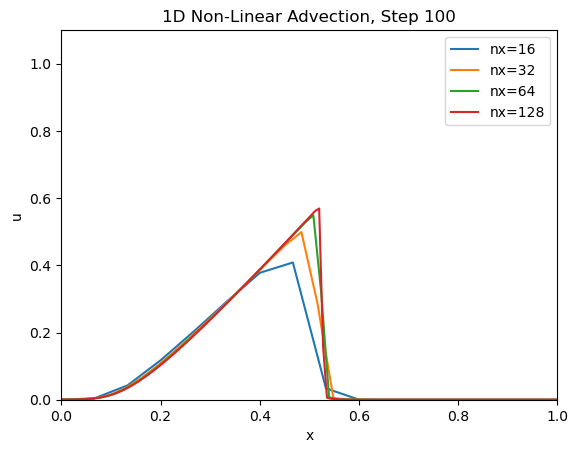

In [37]:
# ftbs for pde2
def ftbs_2(ui, uip1, uim1, uim2, dx, dt):
    return ui - ui*dt/dx*(ui - uim1)

# create fxn for pde2 (no exact soltn)
def pde2(nx, L, dt, nt, ics, fd, fdstr):
    # Setup the grid
    x = np.linspace(0, L, nx)
    dx = L / nx

    # Point to the initial condition you want to use
    initial_conditions = ics

    # Set initial conditions
    u0 = initial_conditions(x)
                            
    # Set up the solution array u
    u = u0.copy()

    # Store solution at each time step
    us = [u.copy()]

    time = 0.0
    for n in range(nt):
        time = time + dt
        # Numerical solution update
        u_new = u.copy()  
        for i in range(1, nx-1):
            # update with fd model
            u_new[i] = fd(u[i], u[i+1], u[i-1], u[i-2], dx, dt)
        u = u_new.copy()
        us.append(u.copy())

    # Save the final result in a file for comparison at a later stage
    np.save(f'Solution-ModelPDE2-{fdstr}_Nx{nx:.0f}.npy', np.array([x,us[-1]]))
    
    return x, us

# now run for each nx w/ given ICs
# Parameters
L = 1.0          # Length of domain
dt = 0.005       # Time step
nt = 100         # Number of time steps

# list of nxs to use
nxs = np.array([16, 32, 64, 128])

# run for each differencing option
us = {}
xs = {}
for nx in nxs:
    # run ft-bs
    x, usftbs = pde2(nx, L, dt, nt, initial_conditions_gaussian, ftbs_2, "ftbs")
    
    # store soltn in dict
    us[nx] = usftbs
    xs[nx] = x

# Animation setup
fig, ax = plt.subplots()
line_solution16, = ax.plot(xs[16], us[16][0], label='nx=16')
line_solution32, = ax.plot(xs[32], us[32][0], label='nx=32')
line_solution64, = ax.plot(xs[64], us[64][0], label='nx=64')
line_solution128, = ax.plot(xs[128], us[128][0], label='nx=128')
ax.set_xlim(0, L)
ax.set_ylim(0, 1.1)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.legend()
ax.set_title(f'1D Non-Linear Advection')

def update(frame):
    line_solution16.set_ydata(us[16][frame])
    line_solution32.set_ydata(us[32][frame])
    line_solution64.set_ydata(us[64][frame])
    line_solution128.set_ydata(us[128][frame])
    ax.set_title(f'1D Non-Linear Advection, Step {frame}')
    return line_solution16, line_solution32, line_solution64, line_solution128

anim = FuncAnimation(fig, update, frames=len(us[16]), blit=True, interval=50)
HTML(anim.to_jshtml())

We should expect to see behavior similar to a shockwave. I would expect to see a single wave front propagating after
enough time steps, and likely with no reduction in magnitude from the initial condition. Instead, we see that the
highest resolution grid approximates a single wave front very well, with a large nearly-vertical wave front. As the grid
resolution is reduced, the wave front becomes less and less vertical and the solution is more diffused, just like what
was seen for PDE1. Interestingly, while the peak magnitude and wave front slope are different for each grid resolution,
the following edge is almost identical for all grid resolutions. Since the exact solution for model PDE2 is very
complicated, there is no error to analyze for this case. However, knowing that this equation is used to model shocks we
can assume that the highest grid resolution is the most accurate solution since it would be most similar to a sharp,
discontinuous wave front like what would be expected from a shockwave.

# Part 3a

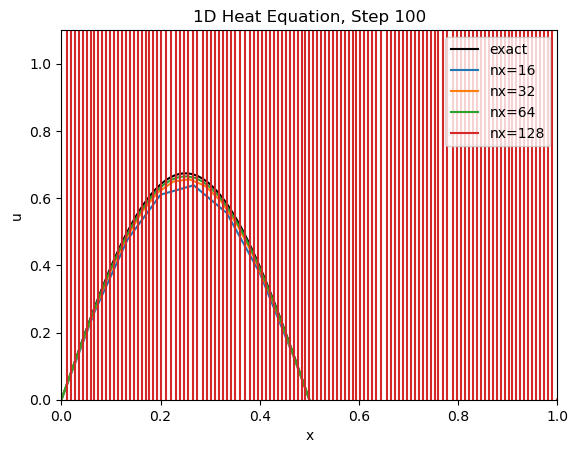

In [46]:
# ftcs for pde3
def ftcs_3(ui, uip1, uim1, uim2, dx, dt, v):
    return ui + v*dt/(dx**2)*(uip1 - 2*ui + uim1)

# create fxn for pde3
def pde3(v, nx, L, dt, nt, ics, fd, fdstr):
    # Setup the grid
    x = np.linspace(0, L, nx)
    dx = L / nx

    # Point to the initial condition you want to use
    initial_conditions = ics

    # Set initial conditions
    u0 = initial_conditions(x, L)

    # Set up the solution array u
    u = u0.copy()

    # Set up the exact solution for reference
    u_exact = u0.copy()

    # Store solution at each time step
    us = [u.copy()]

    # Store exact solution at each time step
    u_exacts = [u_exact.copy()]

    # Save L2 norm errors in an array
    errors = []

    time = 0.0
    for n in range(nt):
        time = time + dt
        # Numerical solution update
        u_new = u.copy()  
        for i in range(1, nx-1):
            # update with fd model
            u_new[i] = fd(u[i], u[i+1], u[i-1], u[i-2], dx, dt, v)
        u = u_new.copy()
        us.append(u.copy())
        
        # Exact solution update
        u_exact = np.sin(2*np.pi*x/L)*np.exp(-v*(2*np.pi/L)**2*time)
        u_exacts.append(u_exact.copy())
        
        # Calculate L2 norm error between numerical and exact solution
        error = 0.0
        for i in range(1,nx-1):
            error = error + (u_exact[i]-u[i])**2
        error = np.sqrt(error/(nx-2))
        errors.append(error)

    # Save the final result in a file for comparison at a later stage
    np.save(f'Solution-ModelPDE3-{fdstr}_Nx{nx:.0f}.npy', np.array([x,us[-1]]))
    
    return x, us, u_exacts, errors

# Parameters
v = 1.0          # Advection speed
L = 1.0          # Length of domain
dt = 0.0001      # Time step
nt = 100         # Number of time steps
nx = 32

# list of nxs to use
nxs = np.array([16, 32, 64, 128])

# run for each differencing option
us = {}
xs = {}
errs = np.empty(4); i=0
for nx in nxs:
    # run ft-bs
    x, usftbs, uexacts, errorsftbs = pde3(v, nx, L, dt, nt, initial_conditions_sine, ftcs_3, "ftcs")
    
    # store soltn in dict
    us[nx] = usftbs
    xs[nx] = x
    errs[i] = errorsftbs[-1]; i+=1

# Animation setup
fig, ax = plt.subplots()
line_exact, = ax.plot(x, uexacts[0], color='k', label='exact')
line_solution16, = ax.plot(xs[16], us[16][0], label='nx=16')
line_solution32, = ax.plot(xs[32], us[32][0], label='nx=32')
line_solution64, = ax.plot(xs[64], us[64][0], label='nx=64')
line_solution128, = ax.plot(xs[128], us[128][0], label='nx=128')
ax.set_xlim(0, L)
ax.set_ylim(0, 1.1)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.legend()
ax.set_title(f'1D Heat Equation')

def update(frame):
    line_solution16.set_ydata(us[16][frame])
    line_solution32.set_ydata(us[32][frame])
    line_solution64.set_ydata(us[64][frame])
    line_solution128.set_ydata(us[128][frame])
    line_exact.set_ydata(uexacts[frame])
    ax.set_title(f'1D Heat Equation, Step {frame}')
    return line_solution16, line_solution32, line_solution64, line_solution128, line_exact

anim = FuncAnimation(fig, update, frames=len(uexacts), blit=True, interval=50)
HTML(anim.to_jshtml())

Similar trends to those observed for model PDEs 1 and 2 can be seen for model PDE 3 as well. The lowest grid resolution
of 16 points diffuses slightly more than the other resolutions tested. However, PDE3 is much more tolerant to low grid
spacings than the previous model PDEs. The lowest resolution case only diffuses a few percent more than the exatct
solution. The 32- and 64-point grids show almost no difference between them. The high resolution grid, however, blows
up. We know that the stability of explicit solvers is based on CFL number. Since we reduced the x step significantly, we
would need to reduce the time step to keep a CFL number that gives a stable solution, but for a constant time step the
high resolution grid is not stable.

discuss error here